# ДЗ №1 Мультимодальный поиск похожих произведений искусства

Представьте: вы пришли в музей или пролистываете онлайн-галерею и находите картину, которая вам особенно нравится.
Возникает естественный вопрос: **а какие ещё произведения похожи на неё?** Может быть, по стилю мазка, по жанру, по настроению, по сюжету. Или, наоборот, хочется задать текстовый запрос — «брейнрот в стиле импрессионизма» — и найти визуально близкие работы. А иногда достаточно одного-двух тегов, чтобы быстро собрать подборку картин в нужной тематике.

Это и есть **мультимодальный поиск**: умение находить объекты в коллекции не только по изображению в качестве запроса, но и по тексту, и по семантическим признакам.  
В этом задании мы сделаем прототип рекомендательной системы для художественных произведений, которая работает сразу на нескольких уровнях:

1. **Image→Image Retrieval** — поиск визуально похожих картин по эмбеддингам.  
2. **Caption→Image Retrieval** — поиск картин по автоматически сгенерированным описаниям (caption).  
3. **Omni→Image Retrieval** — поиск по запросу, жанрам, стилям и прочим тегам, полученным Zero-Shot классификацией.  

Вам необходимо реализовать MVP системы рекомендаций для искусства, где объединяются разные модальности: изображения, текст и мета-информация.  Такой же принцип лежит в основе реальных поисковых и рекомендательных сервисов в индустрии (музыка, видео, маркетплейсы, соцсети).

**Что важно в этой работе:**  
- Понять, как связаны разные модальности через эмбеддинги.  
- Научиться строить индексы и реализовывать поиск.  
- Сгенерировать и опубликовать свои артефакты (caption, лейблы).  
- Критически оценить качество и ограничения.  
- Бонусом — сделать интерактивный сервис, который можно продемонстрировать коллегам и пользоваться самостоятельно.


## Датасет

Для экспериментов мы будем использовать датасет **[WikiArt](https://huggingface.co/datasets/huggan/wikiart)**.  
В нём собраны тысячи картин разных художников, стилей и направлений.

Для экспериментов и построения индексов в целях ускорения вы можете выбрать подвыборку всего датасета (не менее 5000), но явно зафиксируйте это в вашем решении, если будете делать так. Аналогично, вы можете выбрать другой датасет, который подошел бы для выполнения целевых заданий, описанных ниже.

## Задание

### 1. Image→Image Retrieval · до 3 баллов
- **1 балл**: выбор image-encoder и мотивация (почему именно эта модель, продемонстрировать, как получить с помощью нее эмбеддинг изображения).  
- **1 балл**: построение индекса (например, FAISS).  
- **1 балл**: демонстрация работы (показать топ-10 ближайших картин к выбранной для 10 разнообразных примеров).  

### 2. Caption→Image Retrieval · до 3 баллов
- **1 балл**: выбор модели для captioning и описание инференса.  
- **1 балл**: примеры сгенерированных caption (показать в ноутбуке).  
- **1 балл**: реализация и демонстрация работы индекса на основе caption (показать топ-10 ближайших картин к выбранной для 10 разнообразных примеров).
- **1 балл**: публикация датасета с caption на HuggingFace Datasets (например json/csv с полями `image_row`, `caption`, сами изображения загружать не обязательно).  

### 3. Omni→Image Retrieval · до 4 баллов
- **1 балла**: генерация Zero-Shot признаков с помощью VLM.  
- **3 балл**: реализация поиска на основе текстового запроса, жанров, дополнительных признаков. Добавьте возможность поиска изображений различными способами, утилизирующими полученную суррогатную разметку и разные модальности.

### Бонусная часть · до +3 баллов
Реализовать демо (Gradio/Streamlit/Telegram-бот) на основе полученного решения и индексов, по +1 за добавление каждого из описанных выше функционалов в демо.

Ноутбук долден быть воспроизводим, внутри отрисованы все результаты последовательного исполнения ячеек, все шаги подробно аннотированы, датасеты и демо публично доступны.


In [1]:
import os
import pandas as pd
import random
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
from tqdm import tqdm

from typing import List
from dataclasses import dataclass
import faiss
import torch
from datasets import load_dataset
from transformers import AutoProcessor, AutoModel, SiglipModel, AutoImageProcessor
from transformers import CLIPModel, CLIPProcessor, CLIPTokenizer, CLIPImageProcessor
from transformers import BlipProcessor, BlipForConditionalGeneration, Blip2Processor, Blip2ForConditionalGeneration
from huggingface_hub import HfApi, HfFolder, Repository, create_repo

from huggingface_hub import login

# NUM_OF_DATA = 5000 
NUM_OF_DATA = 'ALL'

/opt/miniconda3/envs/my_env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# отрисовка случайных картинок из датасета
def show_random_images(dataset, 
                       dataset_txt=None, 
                       n_rows=3, 
                       n_cols=5, 
                       seed=42, 
                       resize=(256,256)
    ):
    random.seed(seed)
    idxs = random.sample(range(len(dataset)), n_rows * n_cols)

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(3*n_cols, 3*n_rows))
    axes = axes.flatten()

    for ax, idx in zip(axes, idxs):
        img = dataset[idx]["image"].copy()
        img.thumbnail(resize)
        if not dataset_txt:
            style = dataset.features["style"].int2str(dataset[idx].get("style", "-"))
            artist = dataset.features["artist"].int2str(dataset[idx].get("artist", "-"))
            genre = dataset.features["genre"].int2str(dataset[idx].get("genre", "-"))
            ax.set_title(f'{style}\n{artist}\n{genre}', fontsize=8)
        else:
            caption = dataset_txt[idx]["caption"]
            ax.set_title(f'{caption}', fontsize=10)
        ax.imshow(img)
        ax.axis("off")

    plt.tight_layout()
    plt.show()

# отрисовка 10 картинок к запросу по img_emb или txt_emb
def vis_nearest_img(ds, 
                    index, 
                    ds_text=None, 
                    index_text=None, 
                    img_num=10, 
                    img_to_vis=10, 
                    no_repeate=True, 
                    random_state=None, 
                    resize=(256,256)
    ):
    if random_state:
        random.seed(random_state)
    idxs = random.sample(range(len(ds)), img_num)
    
    for qi, q_idx in enumerate(idxs):
        if index_text:
            q_vec = index_text.reconstruct(q_idx).reshape(1, -1).astype("float32")
        else:
            q_vec = index.reconstruct(q_idx).reshape(1, -1).astype("float32")

        
        D, I = index.search(q_vec, img_to_vis + 1)
        I = I[0].tolist()

        if no_repeate and q_idx in I:
            I.remove(q_idx)
        I = I[:img_to_vis]
        
        ncols = (img_to_vis + 1) // 2
        fig, axes = plt.subplots(2, ncols + 1, figsize=(3*(ncols+1), 6))

        img = ds[q_idx]["image"].copy()
        img.thumbnail(resize)
        axes[0,0].imshow(img)
        if ds_text:
            axes[0,0].set_title(f"Query: {ds_text[q_idx]['caption']}", fontsize=10)
        else:
            axes[0,0].set_title("Query", fontsize=10)
        axes[0,0].axis("off")
        axes[1,0].axis("off")

        for j, idx in enumerate(I):
            row = 0 if j < ncols else 1
            col = (j % ncols) + 1
            ax = axes[row, col]
            img = ds[idx]["image"].copy()
            img.thumbnail(resize)
            ax.imshow(img)
            if ds_text:
                caption = ds_text[idx]['caption']
                ax.set_title(f'{caption}', fontsize=10)
            else:
                style = ds.features["style"].int2str(ds[idx].get("style", "-"))
                artist = ds.features["artist"].int2str(ds[idx].get("artist", "-"))
                genre = ds.features["genre"].int2str(ds[idx].get("genre", "-"))
                ax.set_title(f'{style}\n{artist}\n{genre}', fontsize=10)
            ax.axis("off")

        for r in range(2):
            for c in range(ncols+1):
                if (r,c) not in [(0,0)] and (r == 0 and c-1 >= len(I)//2) and (r==1 and c-1 >= len(I)-len(I)//2):
                    axes[r,c].axis("off")

        plt.tight_layout()
        plt.show()
        
def show_random_tags(dataset, 
                       img_index,
                       tag_emb,
                       tag_text,
                       tag_type,
                       n_rows=3, 
                       n_cols=5, 
                       seed=42, 
                       resize=(256,256)
    ):
    random.seed(seed)
    idxs = random.sample(range(len(dataset)), n_rows * n_cols)

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(3*n_cols, 3*n_rows))
    axes = axes.flatten()

    for ax, idx in zip(axes, idxs):
        img = dataset[idx]["image"].copy()
        img.thumbnail(resize)
        
        img_vec = img_index.reconstruct(idx).astype("float32")
        tag_idx = np.argmax(tag_emb @ img_vec)
        pred_tag = tag_text[tag_idx]

        tag = dataset.features[tag_type].int2str(dataset[idx].get(tag_type, "-"))
        
        ax.set_title(f'True tag: {tag}\nZero shot: {pred_tag}', fontsize=8)

        ax.imshow(img)
        ax.axis("off")

    plt.tight_layout()
    plt.show()

# EDA

In [3]:
ds = load_dataset("huggan/wikiart", split="train")

In [4]:
styles = set(ds["style"])
print("Styles:", len(styles), list(map(ds.features["style"].int2str, styles)))
genres = set(ds["genre"])
print("Genres:", len(genres), list(map(ds.features["genre"].int2str, genres)))
artists = set(ds["artist"])
print("Artists:", len(artists), list(map(ds.features["artist"].int2str, artists)))
print(f'DS len={len(ds)}')

Styles: 27 ['Abstract_Expressionism', 'Action_painting', 'Analytical_Cubism', 'Art_Nouveau', 'Baroque', 'Color_Field_Painting', 'Contemporary_Realism', 'Cubism', 'Early_Renaissance', 'Expressionism', 'Fauvism', 'High_Renaissance', 'Impressionism', 'Mannerism_Late_Renaissance', 'Minimalism', 'Naive_Art_Primitivism', 'New_Realism', 'Northern_Renaissance', 'Pointillism', 'Pop_Art', 'Post_Impressionism', 'Realism', 'Rococo', 'Romanticism', 'Symbolism', 'Synthetic_Cubism', 'Ukiyo_e']
Genres: 11 ['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'nude_painting', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life', 'Unknown Genre']
Artists: 129 ['Unknown Artist', 'boris-kustodiev', 'camille-pissarro', 'childe-hassam', 'claude-monet', 'edgar-degas', 'eugene-boudin', 'gustave-dore', 'ilya-repin', 'ivan-aivazovsky', 'ivan-shishkin', 'john-singer-sargent', 'marc-chagall', 'martiros-saryan', 'nicholas-roerich', 'pablo-picasso', 'paul-cezanne', 'pierre-

In [5]:
if isinstance(NUM_OF_DATA, int):
    ds = ds.shuffle(seed=42).select(range(NUM_OF_DATA))
else:
    NUM_OF_DATA = len(ds)
print(len(ds))

81444


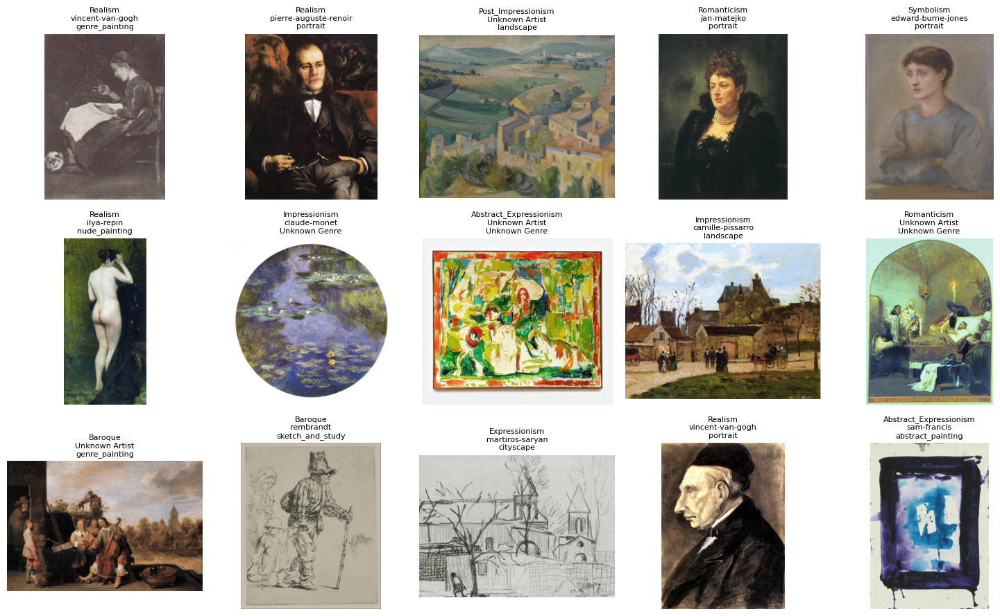

In [6]:
show_random_images(ds, n_rows=3, n_cols=5)

# Task 1: Image→Image Retrieval

In [7]:
class ImgTextEmbeddingModel:
    def __init__(self, 
                 model_name,
                 device=None,
                 token_max_len=77,
                 half=True
    ):
        self.device = device or ("cuda" if torch.cuda.is_available() else "cpu")
        self.token_max_len = token_max_len
        self.processor = AutoProcessor.from_pretrained(model_name,use_fast=True)
        if "clip" in model_name:
            self.tokenizer = CLIPTokenizer.from_pretrained(model_name)
            self.processor = CLIPImageProcessor.from_pretrained(model_name)
            self.model = CLIPModel.from_pretrained(model_name)
            self.model_type = "clip"
        elif "siglip" in model_name:
            self.model = SiglipModel.from_pretrained(model_name)
            self.model_type = "siglip"
        else:
            self.model = AutoModel.from_pretrained(model_name)
            self.model_type = "vision"
        self.model = self.model.to(self.device).eval()

        if half:
            self.model = self.model.half()

    def __call__(self, data, infer_type='img'):
        with torch.no_grad():
            if infer_type=='img':
                inputs = self.processor(images=data, return_tensors="pt").to(self.device)
                if self.model_type in["clip", "siglip"]:
                    feats = self.model.get_image_features(**inputs)
                else: 
                    feats = self.model(**inputs).last_hidden_state[:, 0]
            else:
                if self.model_type == "siglip":
                    inputs = self.processor(
                        text=data, 
                        return_tensors="pt", 
                        padding=True, 
                        truncation=True,
                        max_length=self.token_max_len
                    ).to(self.device)
                elif self.model_type == "clip":
                    inputs = self.tokenizer(data, return_tensors="pt", padding=True, truncation=True).to(self.device)
                    
                feats = self.model.get_text_features(**inputs)
                
            return torch.nn.functional.normalize(feats, dim=-1)
        
    def process_dataset(self, ds, batch_size=10, infer_type='img'):
        embeddings = []
        for i in tqdm(range(0, len(ds), batch_size)):
            if infer_type=='img':
                batch = [ds[j]["image"] for j in range(i, min(i+batch_size, len(ds)))]
            else:
                batch = [ds[j]["caption"] for j in range(i, min(i+batch_size, len(ds)))]
            feats = model(batch, infer_type).cpu().numpy()
            embeddings.append(feats)
        embeddings = np.vstack(embeddings).astype("float32")
        return embeddings

**Мотивация:**

Изначально хотелось опробовать `DINOv3`, тк сами авторы из "книгалицо" говорят, что это foundation model, которая может превосходить специализированные модели в определенных задачах. При обучении v3 видела огромный корпус изображений (вероятно больший чем VLM модели, тк не нужна текстовая пара), что должно давать превосходные эмбединговые представления. 

Однако авторы не дали мне доступ на HF (наверно не нужно было указывать страну...). Потому выбор пал на предыдущую версию `DINOv2` и для сравнения `SigLIP2`, про которую рассказали на лекции.

**Описание получения эмбедингов**:

Для удобства и простоты для получения эмбедингов используется HF с моделями из официальных реп, где можно посмотреть какой препроц заложен авторами (см ниже). 

`DINOv2`: Используется ресайз с пропорциями до 256 и после обрезка до 224х224 от центра. После применяется классическое приведение пикселей 255->1 и как ни странно нормализация по ImageNet, тк мне казалось, что от этого постепенно отказываются (по причине того, что ImageNet хоть и содержит большое колво данных, но все же не полностью описывает общее распределение, на котором учится или используется модель).

После препроца изображение делится на патчи 14х14 для ViT подобного входа, каждый патч линераизуется и подается на вход с позиционными эмбеддингами. В качестве самого эмбединга выступает выход от CLS токена.

`SigLIP2`: Используется ресайз до 224х224 без сохранения пропорций, также 255->1 и приведение к [-1,1] через mean=0.5, std=0.5. После также деление на батчи 14х14 с поз эмбедингами. В качестве выхода вроде бы берется не CLS токен, а среднее выходов всех патчей с проекцией в корректное эмбеддинговое пространство.



In [8]:
proc = AutoProcessor.from_pretrained("facebook/dinov2-base")
print(proc)

proc = AutoImageProcessor.from_pretrained("google/siglip2-base-patch16-224")
print(proc)

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


BitImageProcessor {
  "crop_size": {
    "height": 224,
    "width": 224
  },
  "do_center_crop": true,
  "do_convert_rgb": true,
  "do_normalize": true,
  "do_rescale": true,
  "do_resize": true,
  "image_mean": [
    0.485,
    0.456,
    0.406
  ],
  "image_processor_type": "BitImageProcessor",
  "image_std": [
    0.229,
    0.224,
    0.225
  ],
  "resample": 3,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "shortest_edge": 256
  }
}

SiglipImageProcessor {
  "do_convert_rgb": null,
  "do_normalize": true,
  "do_rescale": true,
  "do_resize": true,
  "image_mean": [
    0.5,
    0.5,
    0.5
  ],
  "image_processor_type": "SiglipImageProcessor",
  "image_std": [
    0.5,
    0.5,
    0.5
  ],
  "processor_class": "SiglipProcessor",
  "resample": 2,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "height": 224,
    "width": 224
  }
}



## DINOv2

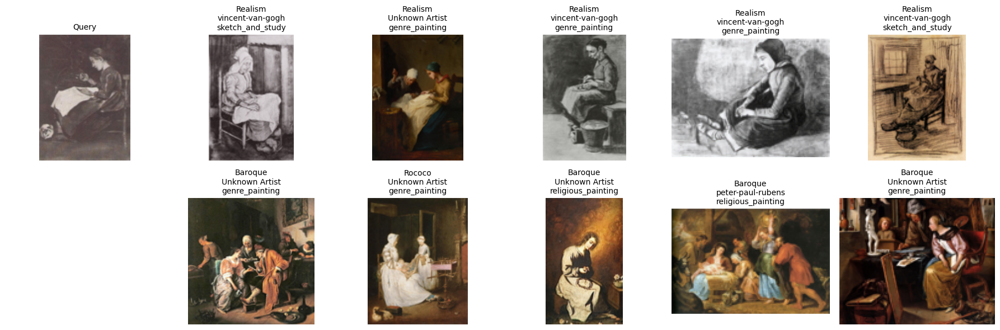

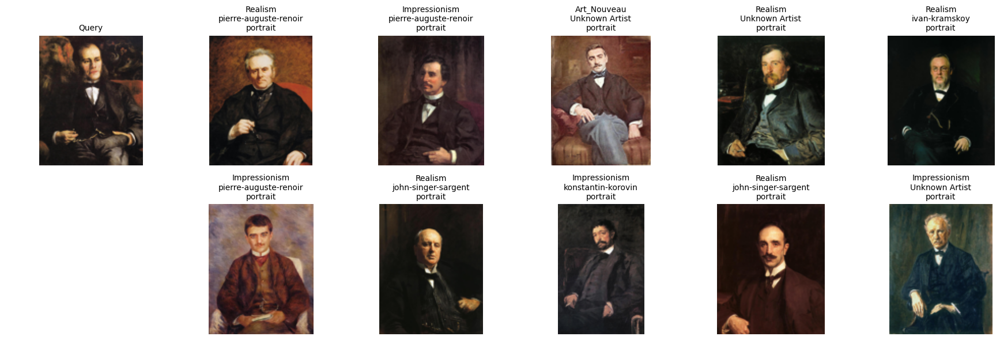

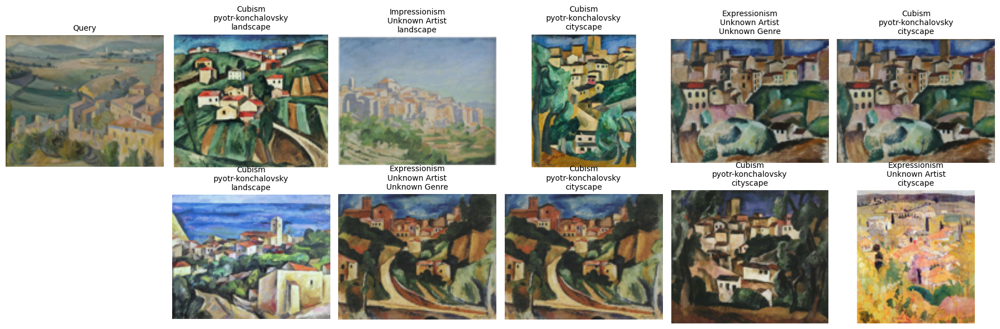

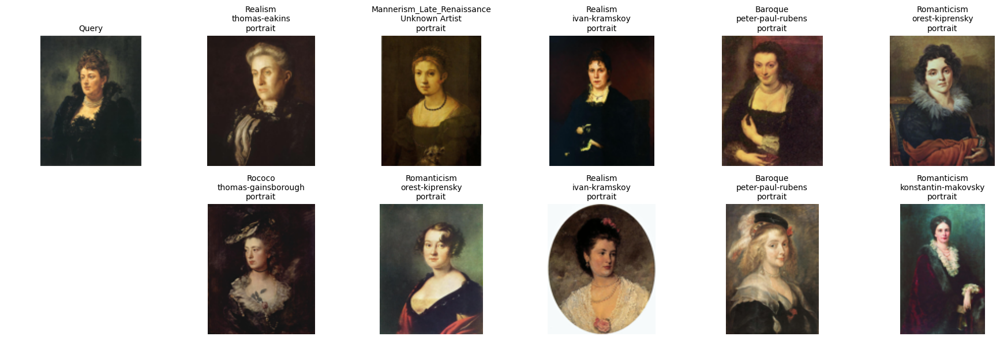

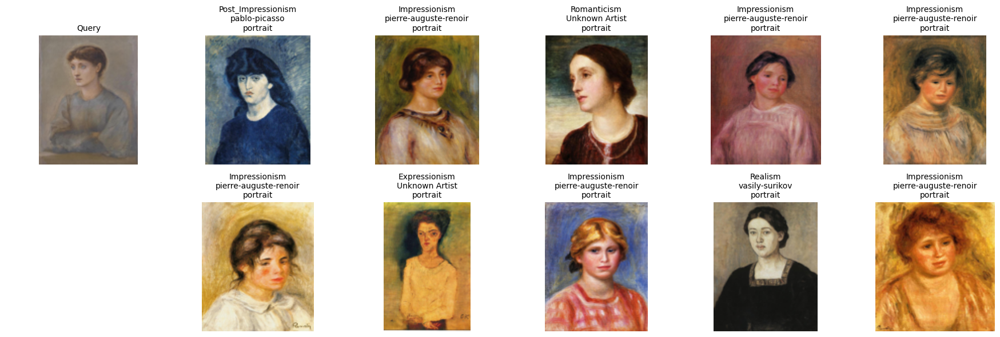

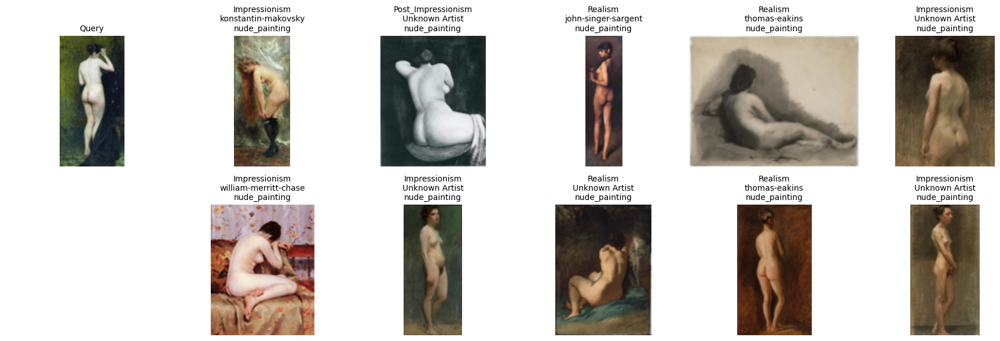

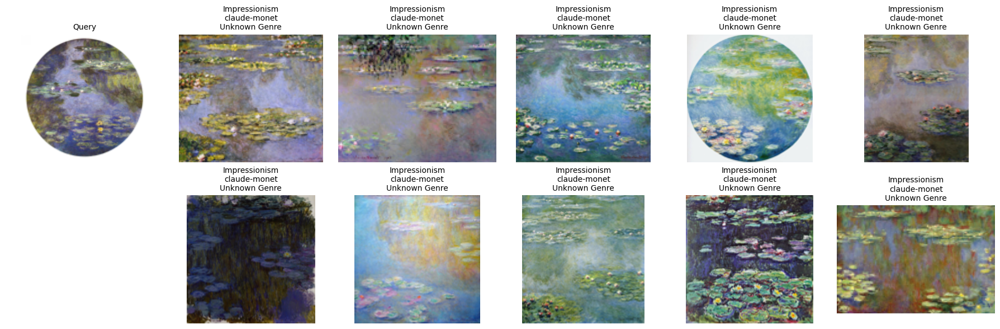

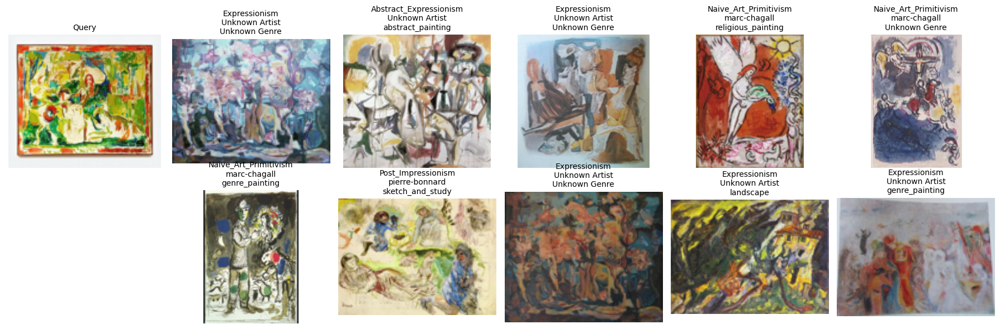

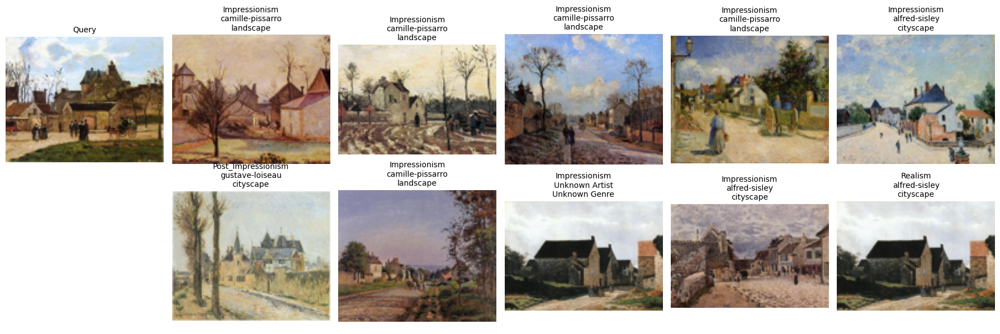

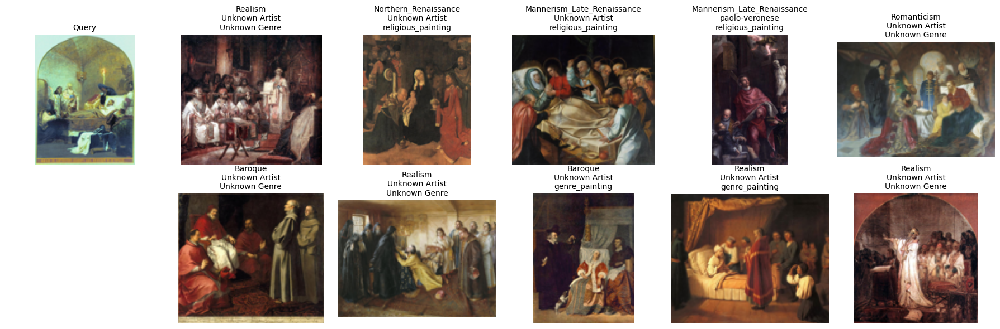

In [9]:
model_name = 'facebook/dinov2-base'
save_path = f"./indexes/{model_name.replace('/','_')}_{NUM_OF_DATA}.index"
os.makedirs(os.path.dirname(save_path), exist_ok=True)
if not os.path.isfile(save_path):
    model = ImgTextEmbeddingModel(model_name, 'cuda')
    embeddings = model.process_dataset(ds, batch_size=300)
    index = faiss.IndexFlatIP(embeddings.shape[1])
    index.add(embeddings)
    faiss.write_index(index, save_path)
else:
    index = faiss.read_index(save_path)

vis_nearest_img(ds, index, no_repeate=True, random_state=42, resize=(128, 128))

# SigLIP

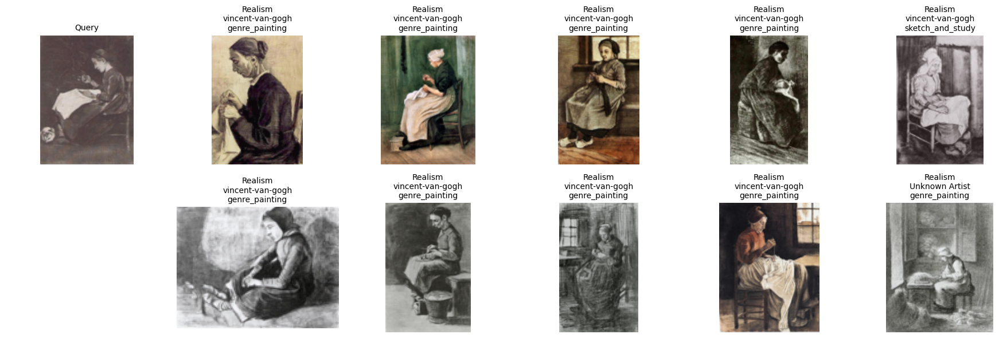

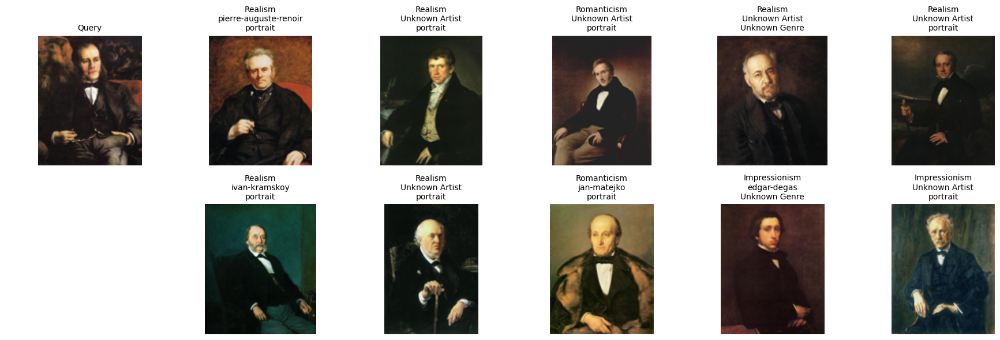

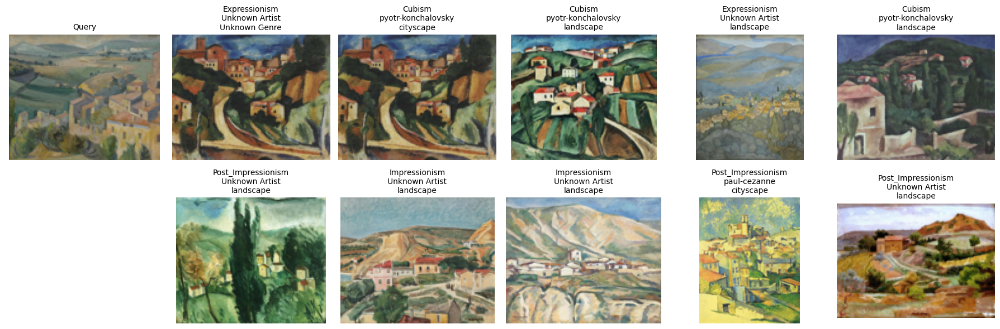

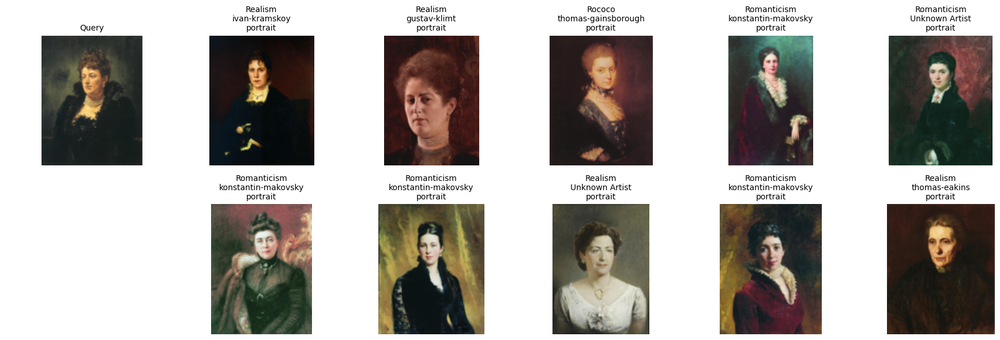

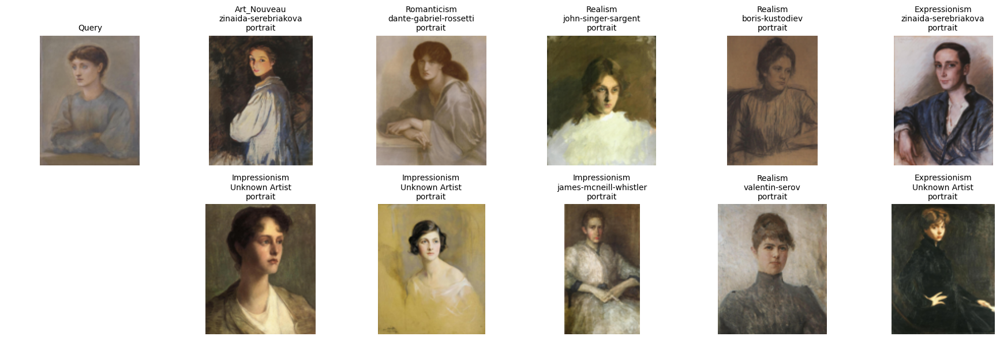

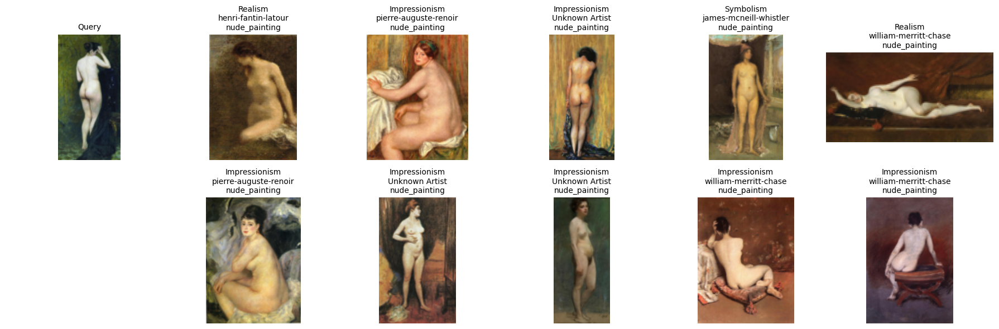

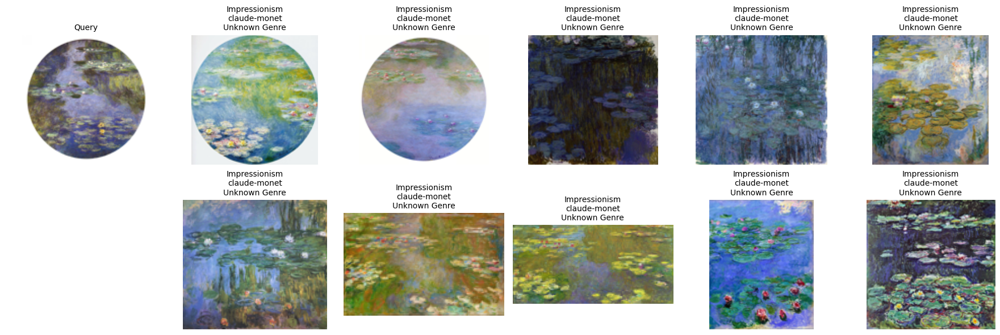

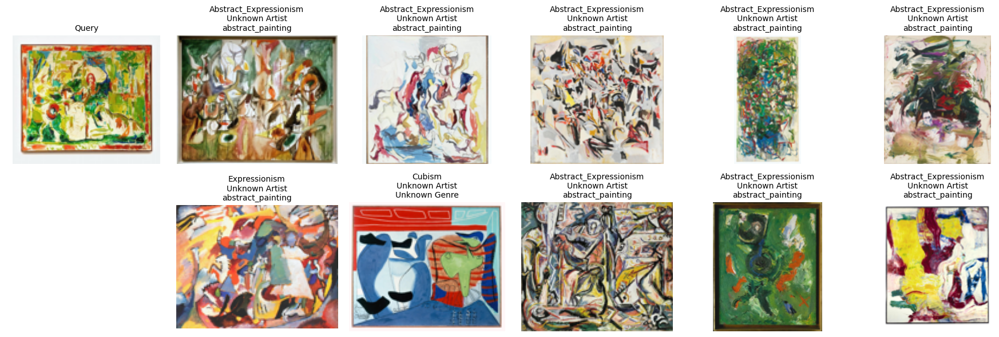

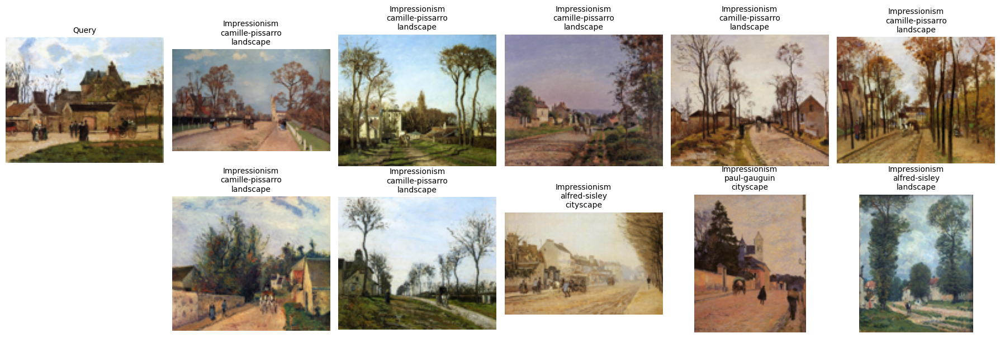

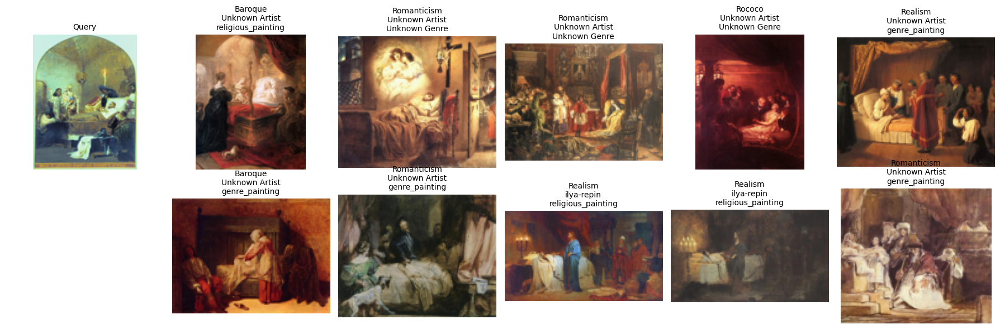

In [10]:
model_name = 'google/siglip2-base-patch16-224'
save_path = f"./indexes/{model_name.replace('/','_')}_{NUM_OF_DATA}.index"
os.makedirs(os.path.dirname(save_path), exist_ok=True)
if not os.path.isfile(save_path):
    model = ImgTextEmbeddingModel(model_name, 'cuda')
    embeddings = model.process_dataset(ds, batch_size=100)
    index = faiss.IndexFlatIP(embeddings.shape[1])
    index.add(embeddings)
    faiss.write_index(index, save_path)
else:
    index = faiss.read_index(save_path)

vis_nearest_img(ds, index, no_repeate=True, random_state=42, resize=(128, 128))

Итог 1:

Обе модели работают довольно хорошо. В обоих случаях найденные картины довольное похожи на запрос. Но для решения следующих заданий DINOv2 не подойдет, тк она чисто картиночная модель.

Эмбеддинги обеих моделей хорошо отражают семантику изображений. Для картин с портретами мужчин ближайшими также будут портреты мужчин (и наоборот для женщин).

# Task 2: Caption→Image Retrieval

In [11]:
class ImgCaptionModel:
    def __init__(self, 
                 model_name,
                 device=None,
                 half=True
    ):
        self.device = device or ("cuda" if torch.cuda.is_available() else "cpu")
        if 'blip2' in model_name:
            self.is_blip2 = True
            self.processor = Blip2Processor.from_pretrained(model_name, use_fast=True)
            self.model = Blip2ForConditionalGeneration.from_pretrained(model_name)
        else:
            self.is_blip2 = False
            self.processor = BlipProcessor.from_pretrained(model_name, use_fast=True)
            self.model = BlipForConditionalGeneration.from_pretrained(model_name)

        self.model = self.model.to(self.device).eval()
        if half:
            self.model = self.model.half()

    def __call__(self, images, promt=None, max_length=30):
        with torch.no_grad():
            inputs = self.processor(
                images=images, 
                text=[promt] * len(images) if promt is not None else None, 
                return_tensors="pt"
            ).to(self.device)

            if self.is_blip2:
                outputs = self.model.generate(**inputs, max_new_tokens=max_length)
                captions = self.processor.batch_decode(outputs, skip_special_tokens=True)
            else:
                outputs = self.model.generate(**inputs, max_length=max_length)
                captions = [self.processor.decode(o, skip_special_tokens=True) for o in outputs]

        return [c.strip() for c in captions]

    def process_dataset(self, ds, promt=None, batch_size=8, max_length=30):
        captions = []
        for i in tqdm(range(0, len(ds), batch_size)):
            batch = [ds[j]["image"] for j in range(i, min(i+batch_size, len(ds)))]
            caps = self(batch, max_length=max_length, promt=promt)
            captions.extend(caps)
        return captions

Для экономии места (тк для выполнения задания используется 8гб vram) был выбран BLIP_1. Данная модель обучалась под несколько задачь сразу: CLIP подобная задача, "подходит ли текст картинке", генерация описания. 

`BLIP` это энкодер-декодер модель с тремя декодерами для каждой задачи. Во время инверенса генерации описания препроцессится изображение (ресайз 384, нормализация, деление на патчи 16х16). К линеаризованным патчам добавляется CLS токен и поз эмбеддинги и подается в ViT энкодер. Текстовый декодер получает на вход BOS токен начала строки, через cross-attention получает визуальные эмбеднги и авторегрессионно строит описание картинки. Также можно вводить начало строки после BOS токена, чтобы модел генерировала текст по подсказке (к сожаление не инструкция).

Для генерации подписей был выбран промт `A painting depicting`

In [12]:
proc = AutoImageProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
print(proc)

BlipImageProcessor {
  "do_convert_rgb": true,
  "do_normalize": true,
  "do_rescale": true,
  "do_resize": true,
  "image_mean": [
    0.48145466,
    0.4578275,
    0.40821073
  ],
  "image_processor_type": "BlipImageProcessor",
  "image_std": [
    0.26862954,
    0.26130258,
    0.27577711
  ],
  "processor_class": "BlipProcessor",
  "resample": 3,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "height": 384,
    "width": 384
  }
}



In [13]:
model_name = "Salesforce/blip-image-captioning-base"
# model_name = "Salesforce/blip2-flan-t5-xl"

promt = 'A painting depicting '

save_path = f"./indexes/{model_name.replace('/','_')}_caption_{NUM_OF_DATA}.txt"
os.makedirs(os.path.dirname(save_path), exist_ok=True)
if not os.path.isfile(save_path):
    model = ImgCaptionModel(model_name, 'cuda')
    captions = model.process_dataset(ds, batch_size=100, promt=promt)

    with open(save_path, "w", encoding="utf-8") as f:
        for cap in captions:
            f.write(cap.strip() + "\n")
else:
    with open(save_path, "r", encoding="utf-8") as f:
        captions = [line.strip() for line in f.readlines()]

In [14]:
captions[:100:20]

['a painting depicting a landscape with trees and a bird flying over it',
 'a painting depicting a woman in a white dress',
 'a painting depicting a vase of flowers and a fan',
 'a painting depicting a woman in a dress',
 'a painting depicting a village with a tree']

Загрузка датасета в `mtvA/wikiart-captions_{NUM_OF_DATA}`

In [15]:
# token = input("token: ")
# login(token)

# df = pd.DataFrame({
#     "image_row": list(range(len(captions))),
#     "caption": captions
# })
# csv_path = "wikiart_captions.csv"
# df.to_csv(csv_path, index=False)

# repo_id = f"mtvA/wikiart-captions_{NUM_OF_DATA}"
# create_repo(repo_id, repo_type="dataset", exist_ok=True)

# api = HfApi()
# api.upload_file(
#     path_or_fileobj=csv_path,
#     path_in_repo="wikiart_captions.csv",
#     repo_id=repo_id,
#     repo_type="dataset"
# )

caption_ds = load_dataset(f"mtvA/wikiart-captions_{NUM_OF_DATA}", split="train")

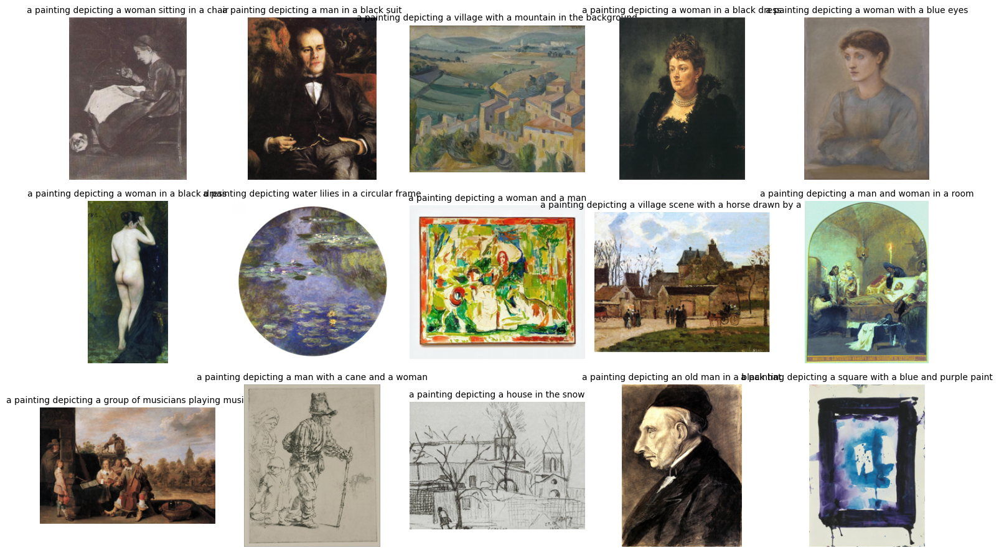

In [18]:
show_random_images(ds, caption_ds)

Для получения эмбедингов описаний и картинок было решено использовать CLIP (вместо siglip), так как по субъективным ощущениям она показыват лучшие результаты на изображениях с wikiARt.

In [20]:
model_name = 'openai/clip-vit-base-patch16'
save_path = f"./indexes/{model_name.replace('/','_')}_{NUM_OF_DATA}_text.index"
os.makedirs(os.path.dirname(save_path), exist_ok=True)
if not os.path.isfile(save_path):
    model = ImgTextEmbeddingModel(model_name, 'cuda')
    embeddings = model.process_dataset(caption_ds, batch_size=100, infer_type='text')
    index_text = faiss.IndexFlatIP(embeddings.shape[1])
    index_text.add(embeddings)
    faiss.write_index(index_text, save_path)
else:
    index_text = faiss.read_index(save_path)


save_path = f"./indexes/{model_name.replace('/','_')}_{NUM_OF_DATA}.index"
os.makedirs(os.path.dirname(save_path), exist_ok=True)
if not os.path.isfile(save_path):
    model = ImgTextEmbeddingModel(model_name, 'cuda')
    embeddings = model.process_dataset(ds, batch_size=100)
    img_index = faiss.IndexFlatIP(embeddings.shape[1])
    img_index.add(embeddings)
    faiss.write_index(img_index, save_path)
else:
    img_index = faiss.read_index(save_path)


Формулировка задания не совсем ясна, потому ниже пример поиска по caption где для эмбединга запроса ищется ближайший среди эмбеддингов caption и эмбеддингов картинок.

### caption_emb->caption_emb

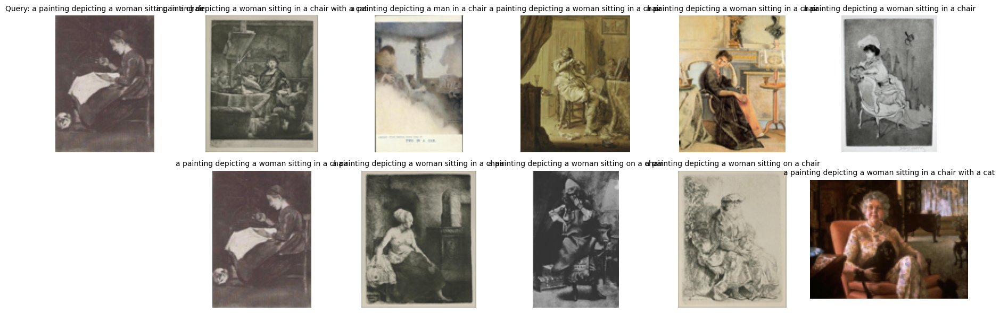

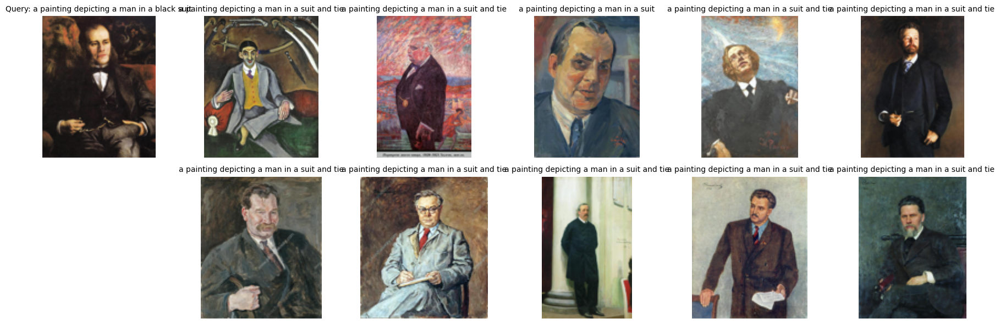

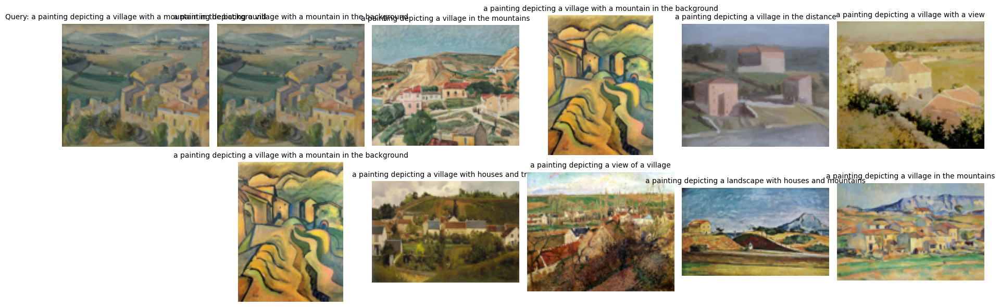

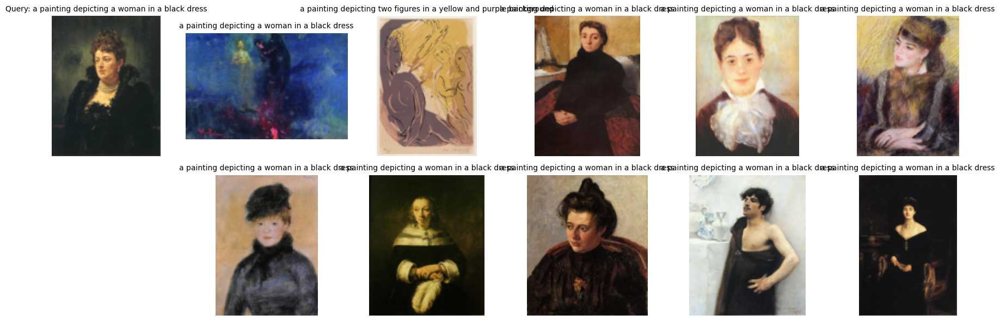

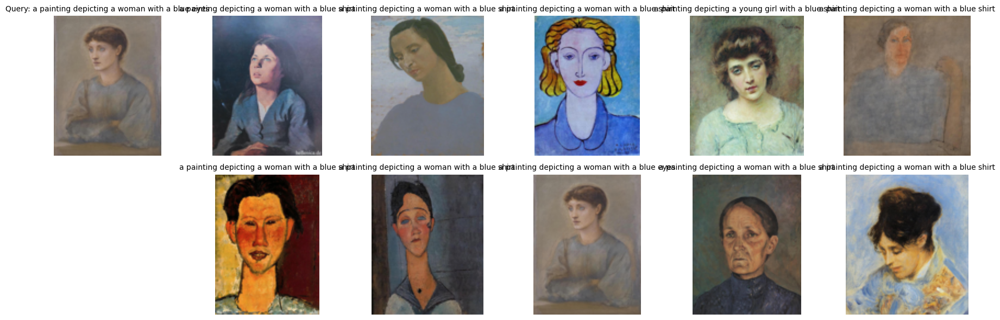

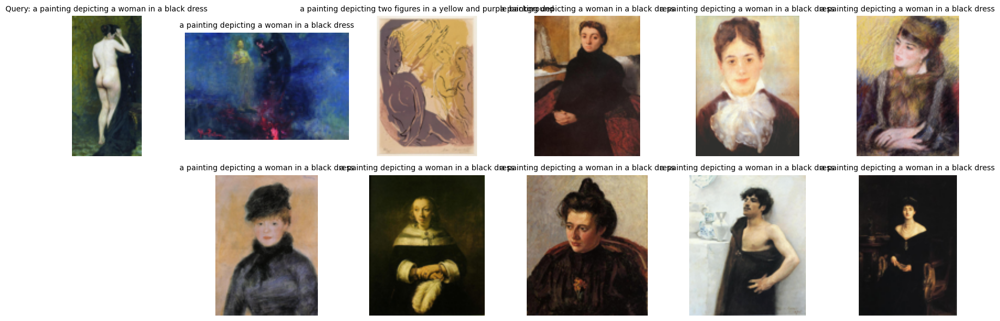

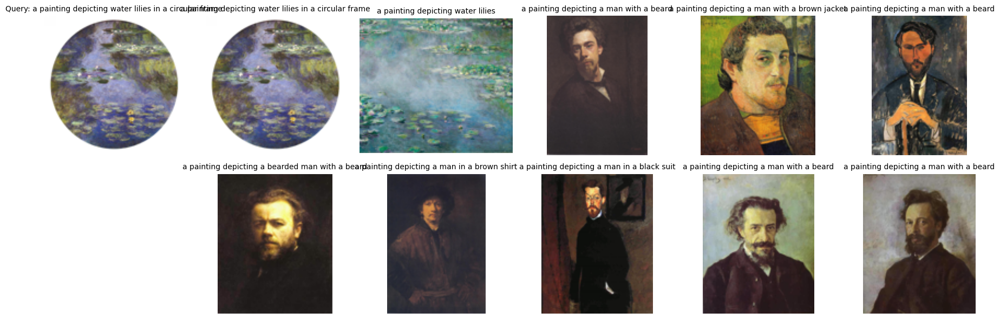

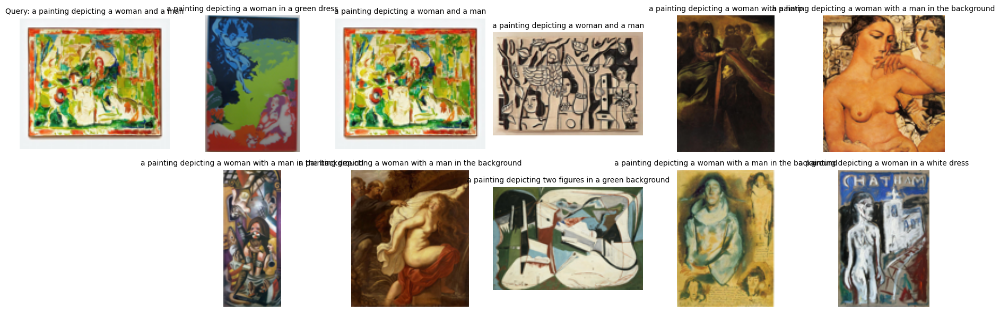

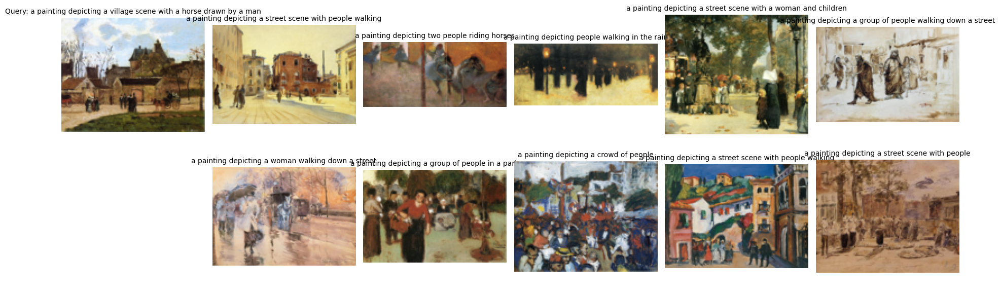

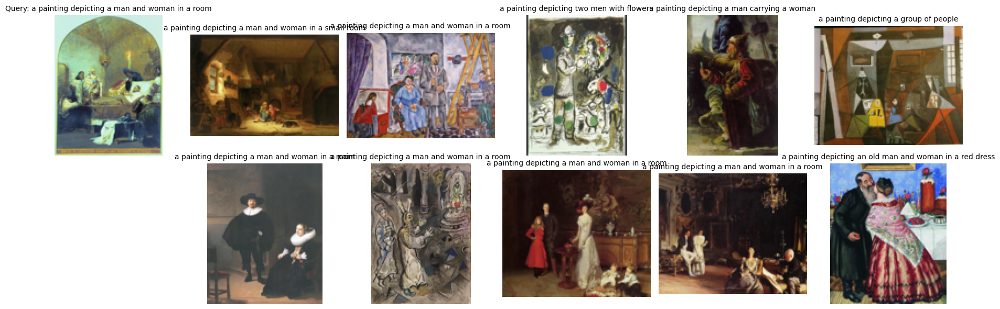

In [21]:
vis_nearest_img(ds, index_text, ds_text=caption_ds, index_text=index_text, no_repeate=False, random_state=42,resize=(128, 128))

### caption_emb->img_emb

In [ ]:
vis_nearest_img(ds, img_index, ds_text=caption_ds, index_text=index_text, no_repeate=False, random_state=42,resize=(128, 128))

Итог 2:

Описание картинк через BLIP получаются довольно хорошими, зачастую близко, но поврхностно описывающими картины. Однако стоит заметить, что для абстрактных картин (без каких то явных объектов) описания получаются максимально скудными.

Касательно поиска `caption_emb->caption_emb` стоит сказать, что подход довольно перегружен и сами автоматические описания картин являются информационным ботлнеком. Качество поиска сильно зависит от глубины описания, но BLIP генерирует короткие подписи, из-за чего теряется большая часть контекста. Более того, для реализации рабочего решения поиска картинки по caption->caption кажется неразумным дополнительно хранить автоподпись. Однако если использовать реально сущесвующие подписи к картинам (описание критиков и тд), это должно вносить пользу, тк текст будет содержать определенный дополнительный контекст в отличии от автоподписей (например чувства, мысли, переживания, когда критик смотрит на картину).

## Task3: Omni→Image Retrieval

In [22]:
styles = list(map(ds.features["style"].int2str, set(ds["style"])))
genres = list(map(ds.features["genre"].int2str, set(ds["genre"])))

# style_prompts = [
#     f"{style.replace('_', ' ')}" for style in styles
# ]
# genre_prompts = [
#     f"{genre.replace('_', ' ')}" for genre in genres
# ]

style_prompts = [
    f"This painting is in the style of {style.replace('_', ' ')}." for style in styles
]
genre_prompts = [
    f"This is a {genre.replace('_', ' ')}." for genre in genres
]


In [23]:
model_name = 'openai/clip-vit-base-patch16'
save_path = f"./tags/{model_name.replace('/','_')}__{NUM_OF_DATA}_tags"
os.makedirs(os.path.dirname(save_path), exist_ok=True)
if not all([os.path.isfile(save_path+p) for p in ['_style.npy', '_genre.npy']]):
    model = ImgTextEmbeddingModel(model_name, 'cuda')
    style_embeddings = model(style_prompts, infer_type='text').cpu().numpy()
    genre_embeddings = model(genre_prompts, infer_type='text').cpu().numpy()

    np.save(save_path+'_style.npy', style_embeddings)
    np.save(save_path+'_genre.npy', genre_embeddings)
else:
    style_embeddings = np.load(save_path+'_style.npy')
    genre_embeddings = np.load(save_path+'_genre.npy')
    

save_path = f"./indexes/{model_name.replace('/','_')}_{NUM_OF_DATA}.index"
os.makedirs(os.path.dirname(save_path), exist_ok=True)
if not os.path.isfile(save_path):
    model = ImgTextEmbeddingModel(model_name, 'cuda')
    embeddings = model.process_dataset(ds, batch_size=100)
    img_index = faiss.IndexFlatIP(embeddings.shape[1])
    img_index.add(embeddings)
    faiss.write_index(img_index, save_path)
else:
    img_index = faiss.read_index(save_path)

Визуализация zero-shot классификации на основе жанров и стилей из разметки датасета wikiArt.

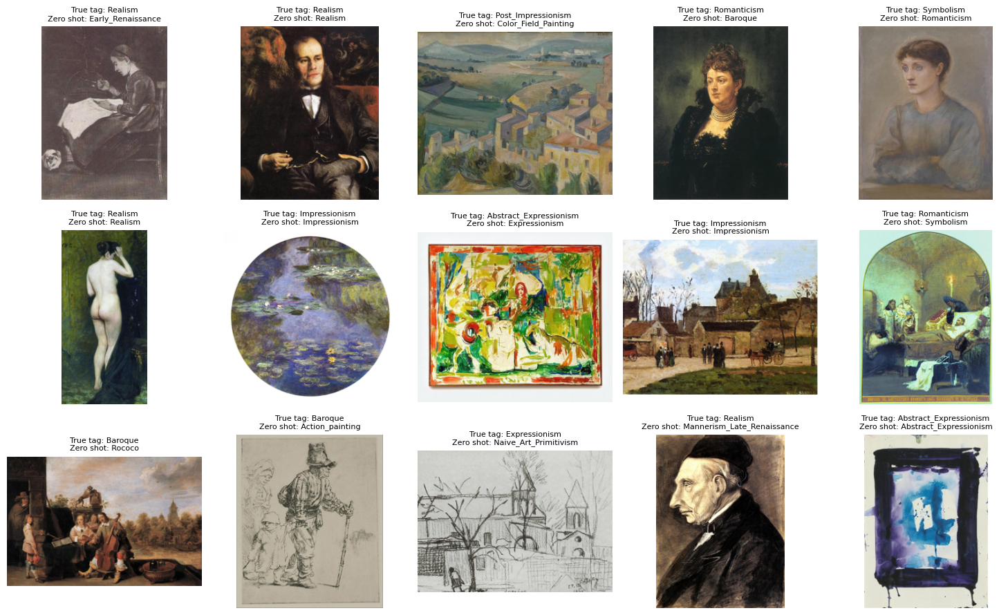

In [24]:
show_random_tags(ds, img_index, style_embeddings, styles, 'style')

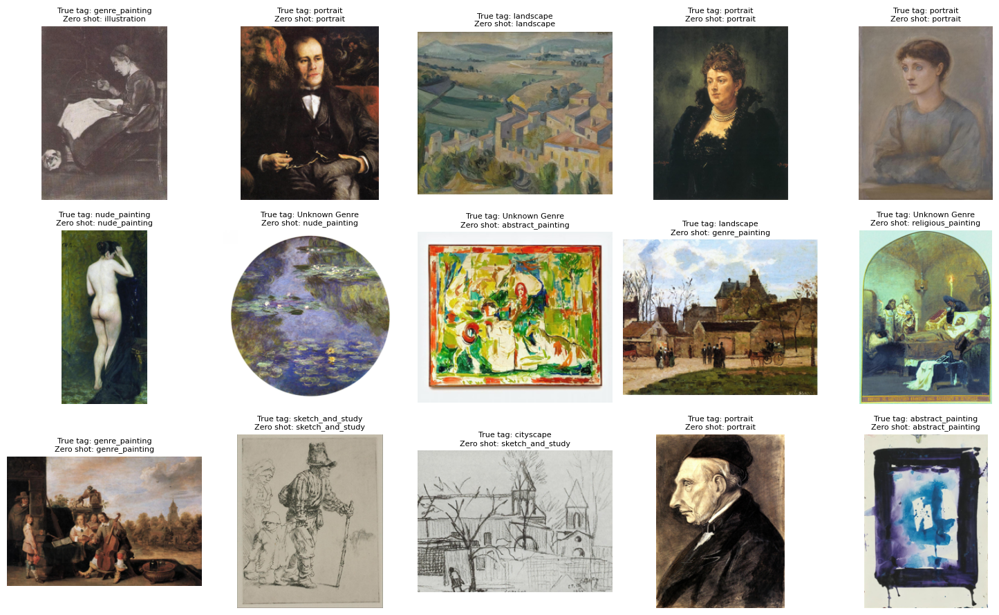

In [25]:
show_random_tags(ds, img_index, genre_embeddings, genres, 'genre')

### Omni search

In [ ]:
def omni_search_filter(
    model,
    query_text,
    img_index,
    tags,
    tags_data,
    prefilter_k = 1000,
    top_k = 10,
):
    q_emb = model(query_text, infer_type='text').cpu().numpy()

    D, I = img_index.search(q_emb.astype("float32"), prefilter_k)
    D, I = D[0], I[0]

    img_embs = np.stack([img_index.reconstruct(int(i)) for i in I])

    mask = np.ones(len(I), dtype=bool)

    for tag_type, tag_values in tags.items():
        if len(tag_values) == 0:
            continue

        tag_info = tags_data[tag_type]
        tag_embs = tag_info.embs
        tag_names = tag_info.value

        target_tag_idxs = [tag_names.index(t) for t in tag_values if t in tag_names]

        tag_scores = img_embs @ tag_embs.T
        best_idx = np.argmax(tag_scores, axis=1)

        tag_mask = np.array([bt in target_tag_idxs for bt in best_idx])
        mask &= tag_mask

    I_filtered = I[mask]
    D_filtered = D[mask]
    
    top_idx = I_filtered[np.argsort(D_filtered)[::-1][:top_k]]

    return top_idx

def omni_search_weighted(
    model,
    query_text,
    img_index,
    tags,
    tags_data,
    tags_w,
    prefilter_k=1000,
    top_k=10,
    w_txt=0.7,
):

    q_emb = model(query_text, infer_type='text').cpu().numpy()
    q_emb /= np.linalg.norm(q_emb)

    D, I = img_index.search(q_emb.astype("float32"), prefilter_k)
    D, I = D[0], I[0]

    img_embs = np.stack([img_index.reconstruct(int(i)) for i in I])
    img_embs /= np.linalg.norm(img_embs, axis=1, keepdims=True)

    sim_total = w_txt * D.copy()

    for tag_type, tag_values in tags.items():
        if len(tag_values) == 0:
            continue

        tag_info = tags_data[tag_type]
        tag_embs = tag_info.embs
        tag_names = tag_info.value

        
        target_idxs = [tag_names.index(t) for t in tag_values if t in tag_names]
        tag_scores = img_embs @ tag_embs.T

        tag_sim = np.max(tag_scores[:, target_idxs], axis=1)
        sim_total += tags_w[tag_type] * tag_sim

    top_idx = I[np.argsort(sim_total)[::-1][:top_k]]
    return top_idx

def omni_search_promt(
    model,
    query_text,
    img_index,
    tags,
    prefilter_k=1000,
    top_k=10,
):
    parts = [query_text]

    for tag_type, tag_values in tags.items():
        if len(tag_values) == 0:
            continue
        joined = ", ".join(tag_values)
        parts.append(f"{tag_type}: {joined}")

    q_aug = ", ".join(parts)

    q_emb = model(q_aug, infer_type='text').cpu().numpy()
    q_emb /= np.linalg.norm(q_emb)

    D, I = img_index.search(q_emb.astype("float32"), prefilter_k)
    I, D = I[0], D[0]
    top_idx = I[np.argsort(D)[::-1][:top_k]]

    return top_idx



In [ ]:
def show_images_by_index(ds, indices, ncols=5, figsize=(6, 6), title=None):
    n_imgs = len(indices)
    if n_imgs == 0:
        return

    ncols = min(ncols, n_imgs)
    nrows = (n_imgs + ncols - 1) // ncols

    fig, axes = plt.subplots(nrows, ncols, figsize=figsize)
    axes = np.array(axes).reshape(-1)

    if title:
        fig.suptitle(title, fontsize=14)

    for ax, idx in zip(axes, indices):
        idx = int(idx)
        img = ds[idx]["image"]
        ax.imshow(img)
        ax.set_title(str(idx), fontsize=8)
        ax.axis("off")

        style = ds.features["style"].int2str(ds[idx].get("style", "-"))
        genre = ds.features["genre"].int2str(ds[idx].get("genre", "-"))
        ax.set_title(f'{style}\n{genre}', fontsize=8)

    for ax in axes[n_imgs:]:
        ax.axis("off")

    plt.tight_layout()
    plt.show()

Для решения задачи омни-поиска были рассмотрены разные подходы. Общее для всех - из картиночного индекса выбираются top-k (1000) ближайших по запросу текстового эмбединга. Сами подходы:

- filter_by_tags: фильтрация по top-1 zero-shot тэгам. Картинам были присвоины теги, по которым просто происходит фильтрация. Порядок остается прежним, уходят лишние.

- late_Fusion: перевзвешивание косинусной близости с использованием близости предсказанных тегов к картинкам. Для полученных 1000 ищображений считается косинусная близость по текстовому запросу и по выбранным тегам. После чего считается итоговый скор близости с учетом весов для каждого признака.

- promt: добавление тегов в текст запроса (не подходит под контекст zero-shot, но как по мне самый логичный и удобный подход). Сразу берутся топ 10 изображений на основе запроса, содержащего нужные теги.


In [26]:
@dataclass
class TagData:
    value: List[str]
    embs: np.array

style_data = TagData(value=styles, embs=style_embeddings)
genre_data = TagData(value=genres, embs=style_embeddings)

text_query = 'a painting of trees and a lake'

# Выбираем целевые теги
tags = {
    'genres':['landscape'],
    'styles':['Baroque']
}
tags_data = {
    'genres':genre_data,
    'styles':style_data
}

# выбираем веса для перевзвешивания близости
tags_w = {
    'genres':0.3,
    'styles':0.9
}

model_name = 'openai/clip-vit-base-patch16'
model = ImgTextEmbeddingModel(model_name, 'cuda')

### filter_by_tags

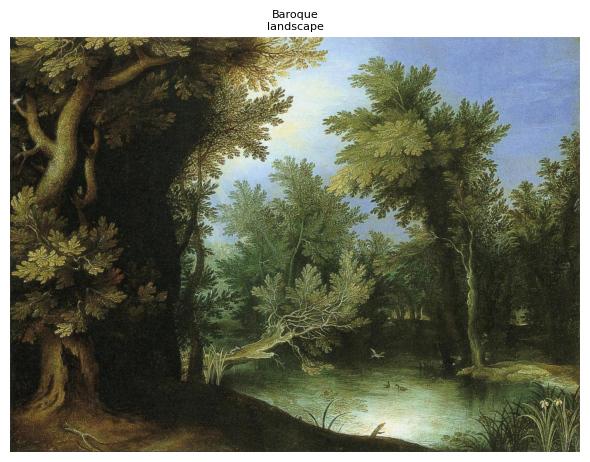

In [27]:
indx = omni_search_filter(model, text_query, img_index, tags, tags_data)
show_images_by_index(ds, indx)

### late_Fusion

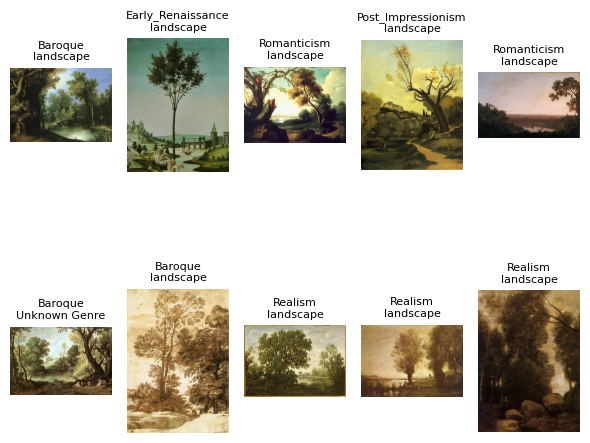

In [28]:
indx = omni_search_weighted(model, text_query, img_index, tags, tags_data, tags_w)
show_images_by_index(ds, indx)

### promt

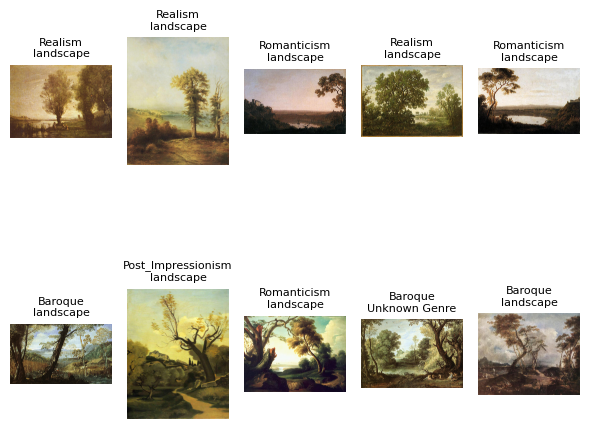

In [29]:
indx = omni_search_promt(model, text_query, img_index, tags)
show_images_by_index(ds, indx)

Итог 3:

Иоговый подход - late_Fusion. Он обладет всеми ребованиями: использует zero-shot теги для омнипосика по картинкам, но также позволяет настраивать влияение каждого признака. С одной стороны это хорошо, тк тэги дискретны, а модели получения эмбединга изображения могут не отличать Baroque от Romanticism (как и я). Но с другой стороны это вносит дополнительные параметры при использовании, что может быть неудобно.

Подход filter_by_tags крайне простой, но в то же время не гибкий. Если zero-shot ошибся, то в выходе картинок не будет. Можно добавить сравнение по какому то трешхолду, те для каждого изображения определять близость каждого тега и фильтровать если вероятность тега меньше заданного.